<a href="https://colab.research.google.com/github/MushroomFleet/StableCascade-text2image/blob/main/240212_StableCascade_text2image.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Drift Johnson's Stable Cascade txt2img / image variation / img2img

https://www.fivebelowfive.uk

# Check Prequisites

In [1]:
# Check the GPU
!nvidia-smi

Wed Feb 14 02:16:19 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  NVIDIA A100-SXM4-40GB          Off | 00000000:00:04.0 Off |                    0 |
| N/A   30C    P0              49W / 400W |      2MiB / 40960MiB |      0%      Default |
|                                         |                      |             Disabled |
+-----------------------------------------+----------------------+--

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# Install Dependencies

In [3]:
!git clone https://github.com/Stability-AI/StableCascade.git
%cd StableCascade
!pip install -r requirements.txt

fatal: destination path 'StableCascade' already exists and is not an empty directory.
/content/StableCascade
Looking in links: https://download.pytorch.org/whl/torch_stable.html
  Cloning https://github.com/ildoonet/pytorch-gradual-warmup-lr.git to /tmp/pip-install-xtcn2ae4/warmup-scheduler_4beae4450109447a89a7d2124c4a730c
  Running command git clone --filter=blob:none --quiet https://github.com/ildoonet/pytorch-gradual-warmup-lr.git /tmp/pip-install-xtcn2ae4/warmup-scheduler_4beae4450109447a89a7d2124c4a730c
  Resolved https://github.com/ildoonet/pytorch-gradual-warmup-lr.git to commit 6b5e8953a80aef5b324104dc0c2e9b8c34d622bd
  Preparing metadata (setup.py) ... done
  Cloning https://github.com/pabloppp/pytorch-tools to /tmp/pip-install-xtcn2ae4/torchtools_99d6c4ec51a14767aac37f40c2e37df1
  Running command git clone --filter=blob:none --quiet https://github.com/pabloppp/pytorch-tools /tmp/pip-install-xtcn2ae4/torchtools_99d6c4ec51a14767aac37f40c2e37df1
  Resolved https://github.com/pab

# If asked above, click "RESTART SESSION" and start from the top before continuing.

In [4]:
import os
import yaml
import torch
from tqdm import tqdm

os.chdir('/content/StableCascade')
from inference.utils import *
from core.utils import load_or_fail
from train import WurstCoreC, WurstCoreB

%cd /content/StableCascade
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)

/content/StableCascade
cuda:0


# Load config

In [5]:
# SETUP STAGE C
config_file = '/content/StableCascade/configs/inference/stage_c_3b.yaml'
with open(config_file, "r", encoding="utf-8") as file:
    loaded_config = yaml.safe_load(file)

core = WurstCoreC(config_dict=loaded_config, device=device, training=False)

# SETUP STAGE B
config_file_b = '/content/StableCascade/configs/inference/stage_b_3b.yaml'
with open(config_file_b, "r", encoding="utf-8") as file:
    config_file_b = yaml.safe_load(file)

core_b = WurstCoreB(config_dict=config_file_b, device=device, training=False)

['model_version', 'effnet_checkpoint_path', 'previewer_checkpoint_path']
['model_version', 'stage_a_checkpoint_path', 'effnet_checkpoint_path']


# Load Extras & Models

In [6]:
#!/bin/bash
%cd /content/StableCascade/models
!bash download_models.sh essential big-big bfloat16
%cd /content/StableCascade

/content/StableCascade/models
stage_a.safetensors 100%[===================>]  70.24M   210MB/s    in 0.3s    
previewer.safetenso 100%[===================>]  15.21M  --.-KB/s    in 0.1s    
effnet_encoder.safe 100%[===================>]  77.73M   220MB/s    in 0.4s    
stage_b_bf16.safete 100%[===================>]   2.91G   172MB/s    in 9.2s    
stage_c_bf16.safete 100%[===================>]   6.68G   361MB/s    in 19s     
/content/StableCascade


In [7]:
# SETUP MODELS & DATA
extras = core.setup_extras_pre()
models = core.setup_models(extras)
models.generator.eval().requires_grad_(False)
print("STAGE C READY")

extras_b = core_b.setup_extras_pre()
models_b = core_b.setup_models(extras_b, skip_clip=True)
models_b = WurstCoreB.Models(
   **{**models_b.to_dict(), 'tokenizer': models.tokenizer, 'text_model': models.text_model}
)
models_b.generator.bfloat16().eval().requires_grad_(False)
print("STAGE B READY")

['transforms', 'clip_preprocess', 'gdf', 'sampling_configs', 'effnet_preprocess']


Downloading: "https://download.pytorch.org/models/efficientnet_v2_s-dd5fe13b.pth" to /root/.cache/torch/hub/checkpoints/efficientnet_v2_s-dd5fe13b.pth
100%|██████████| 82.7M/82.7M [00:00<00:00, 170MB/s]
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:88: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


tokenizer_config.json:   0%|          | 0.00/904 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/862k [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/2.22M [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/389 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/4.88k [00:00<?, ?B/s]

pytorch_model.bin.index.json:   0%|          | 0.00/120k [00:00<?, ?B/s]

pytorch_model-00001-of-00002.bin:   0%|          | 0.00/9.99G [00:00<?, ?B/s]

pytorch_model-00002-of-00002.bin:   0%|          | 0.00/169M [00:00<?, ?B/s]

Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]

config.json:   0%|          | 0.00/4.52k [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/1.71G [00:00<?, ?B/s]

['tokenizer', 'text_model', 'generator', 'effnet', 'previewer']
STAGE C READY
['transforms', 'clip_preprocess', 'gdf', 'sampling_configs', 'effnet_preprocess']
['tokenizer', 'text_model', 'generator', 'effnet', 'stage_a']
['tokenizer', 'text_model', 'generator', 'effnet', 'stage_a']
STAGE B READY


# Optional: Compile Stage C and Stage B

Note: This will increase speed inference by about 2x, but will initially take a few minutes to compile. Moreover, currently using torch.compile only works for a single image resolution, e.g. 1024 x 1024. If you use a different size, it will recompile. See more here.

In [8]:
models = WurstCoreC.Models(
   **{**models.to_dict(), 'generator': torch.compile(models.generator, mode="reduce-overhead", fullgraph=True)}
)

models_b = WurstCoreB.Models(
   **{**models_b.to_dict(), 'generator': torch.compile(models_b.generator, mode="reduce-overhead", fullgraph=True)}
)

['tokenizer', 'text_model', 'generator', 'effnet', 'previewer']
['tokenizer', 'text_model', 'generator', 'effnet', 'stage_a']


In [13]:
!export LC_ALL="en_US.UTF-8"
!export LD_LIBRARY_PATH="/usr/lib64-nvidia"
!export LIBRARY_PATH="/usr/local/cuda/lib64/stubs"
!ldconfig /usr/lib64-nvidia

/sbin/ldconfig.real: /usr/local/lib/libtbbmalloc.so.2 is not a symbolic link

/sbin/ldconfig.real: /usr/local/lib/libtbbbind_2_5.so.3 is not a symbolic link

/sbin/ldconfig.real: /usr/local/lib/libtbb.so.12 is not a symbolic link

/sbin/ldconfig.real: /usr/local/lib/libtbbbind_2_0.so.3 is not a symbolic link

/sbin/ldconfig.real: /usr/local/lib/libtbbmalloc_proxy.so.2 is not a symbolic link

/sbin/ldconfig.real: /usr/local/lib/libtbbbind.so.3 is not a symbolic link



# Text-to-Image

100%|██████████| 10/10 [00:06<00:00,  1.50it/s]


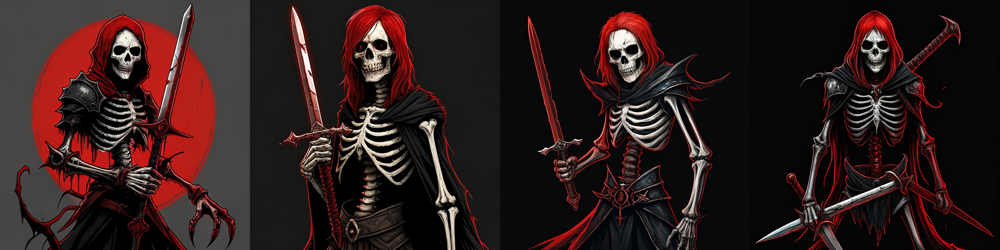

In [28]:
batch_size = 4 # @param {type:'number'}
# @markdown ### Prompt:
prompt = "AssassinKahb style a demonic looking skeleton holding a sword with red hair" # @param {type:'string'}
height, width = 1024, 1024
stage_c_latent_shape, stage_b_latent_shape = calculate_latent_sizes(height, width, batch_size=batch_size)

# @markdown ### Stage C Parameters
Ccfg = 4 # @param {type:'number'}
Cshift = 2 # @param {type:'number'}
Ctimesteps = 20 # @param {type:'number'}
Ct_start = 1.0 # @param {type:'number'}

# @markdown ### Stage B Parameters
Bcfg = 1.1 # @param {type:'number'}
Bshift = 1 # @param {type:'number'}
Btimesteps = 10 # @param {type:'number'}
Bt_start = 1.0 # @param {type:'number'}


batch_size = 4
# Prompt:
caption = prompt
height, width = 1024, 1024
stage_c_latent_shape, stage_b_latent_shape = calculate_latent_sizes(height, width, batch_size=batch_size)

# Stage C Parameters
extras.sampling_configs['cfg'] = Ccfg
extras.sampling_configs['shift'] = Cshift
extras.sampling_configs['timesteps'] = Ctimesteps
extras.sampling_configs['t_start'] = Ct_start

# Stage B Parameters
extras_b.sampling_configs['cfg'] = Bcfg
extras_b.sampling_configs['shift'] = Bshift
extras_b.sampling_configs['timesteps'] = Btimesteps
extras_b.sampling_configs['t_start'] = Bt_start

# PREPARE CONDITIONS
batch = {'captions': [caption] * batch_size}
conditions = core.get_conditions(batch, models, extras, is_eval=True, is_unconditional=False, eval_image_embeds=False)
unconditions = core.get_conditions(batch, models, extras, is_eval=True, is_unconditional=True, eval_image_embeds=False)
conditions_b = core_b.get_conditions(batch, models_b, extras_b, is_eval=True, is_unconditional=False)
unconditions_b = core_b.get_conditions(batch, models_b, extras_b, is_eval=True, is_unconditional=True)

with torch.no_grad(), torch.cuda.amp.autocast(dtype=torch.bfloat16):
    # torch.manual_seed(42)

    sampling_c = extras.gdf.sample(
        models.generator, conditions, stage_c_latent_shape,
        unconditions, device=device, **extras.sampling_configs,
    )
    for (sampled_c, _, _) in tqdm(sampling_c, total=extras.sampling_configs['timesteps']):
        sampled_c = sampled_c

    # preview_c = models.previewer(sampled_c).float()
    # show_images(preview_c)

    conditions_b['effnet'] = sampled_c
    unconditions_b['effnet'] = torch.zeros_like(sampled_c)

    sampling_b = extras_b.gdf.sample(
        models_b.generator, conditions_b, stage_b_latent_shape,
        unconditions_b, device=device, **extras_b.sampling_configs
    )
    for (sampled_b, _, _) in tqdm(sampling_b, total=extras_b.sampling_configs['timesteps']):
        sampled_b = sampled_b
    sampled = models_b.stage_a.decode(sampled_b).float()

show_images(sampled)

save the images

In [29]:
from PIL import Image
import torchvision.transforms as T
import os
from datetime import datetime

# Set the directory where you want to save the images
save_dir = "/content/cascade_output"
# Create the directory if it does not exist
os.makedirs(save_dir, exist_ok=True)

# Convert PyTorch tensor to PIL Images and save them
transform = T.ToPILImage()

for i, img_tensor in enumerate(sampled):
    # Generate a timestamp
    timestamp = datetime.now().strftime("%Y%m%d_%H%M%S%f")
    # Convert tensor to PIL Image
    img = transform(img_tensor.cpu())
    # Save the image with the full path and timestamp to ensure uniqueness
    img.save(os.path.join(save_dir, f'cascade_txt2img_{i}_{timestamp}.png'))


# Image Variation

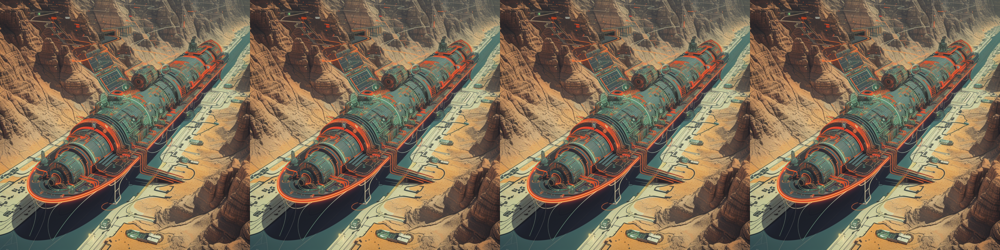

In [30]:
# @markdown ## Image URL
imgurl = "https://cdn.discordapp.com/attachments/989484060504109066/1205756614221496320/driftjohnson_CubicFuturism_style_super_futurism_cargo_ship_is_i_cf60c36f-e7c0-43ae-919a-b3fc66bbc937.png?ex=65d9875a&is=65c7125a&hm=35823f3625f3a19b28ccbe5ff82ce3f6dc52277d0cb3d83ade9af7624f6aea0c&" # @param {type:'string'}


batch_size = 4

url = imgurl
images = resize_image(download_image(url)).unsqueeze(0).expand(batch_size, -1, -1, -1).to(device)

batch = {'images': images}

show_images(batch['images'])

/usr/local/lib/python3.10/dist-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  warnings.warn(
100%|██████████| 10/10 [00:06<00:00,  1.50it/s]


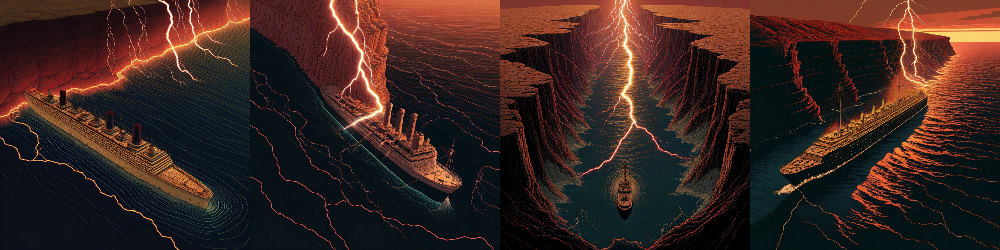

In [17]:
# @markdown ### empty prompt for image variation;

# @markdown ### Stage C Parameters
Ccfg = 4 # @param {type:'number'}
Cshift = 2 # @param {type:'number'}
Ctimesteps = 20 # @param {type:'number'}
Ct_start = 1.0 # @param {type:'number'}

# @markdown ### Stage B Parameters
Bcfg = 1.1 # @param {type:'number'}
Bshift = 1 # @param {type:'number'}
Btimesteps = 10 # @param {type:'number'}
Bt_start = 1.0 # @param {type:'number'}


# empty prompt
caption = ""
height, width = 1024, 1024
stage_c_latent_shape, stage_b_latent_shape = calculate_latent_sizes(height, width, batch_size=batch_size)

# Stage C Parameters
extras.sampling_configs['cfg'] = Ccfg
extras.sampling_configs['shift'] = Cshift
extras.sampling_configs['timesteps'] = Ctimesteps
extras.sampling_configs['t_start'] = Ct_start

# Stage B Parameters
extras_b.sampling_configs['cfg'] = Bcfg
extras_b.sampling_configs['shift'] = Bshift
extras_b.sampling_configs['timesteps'] = Btimesteps
extras_b.sampling_configs['t_start'] = Bt_start

# PREPARE CONDITIONS
batch['captions'] = [caption] * batch_size

with torch.no_grad(), torch.cuda.amp.autocast(dtype=torch.bfloat16):
    # torch.manual_seed(42)
    conditions = core.get_conditions(batch, models, extras, is_eval=True, is_unconditional=False, eval_image_embeds=True)
    unconditions = core.get_conditions(batch, models, extras, is_eval=True, is_unconditional=True, eval_image_embeds=False)
    conditions_b = core_b.get_conditions(batch, models_b, extras_b, is_eval=True, is_unconditional=False)
    unconditions_b = core_b.get_conditions(batch, models_b, extras_b, is_eval=True, is_unconditional=True)

    sampling_c = extras.gdf.sample(
        models.generator, conditions, stage_c_latent_shape,
        unconditions, device=device, **extras.sampling_configs,
    )
    for (sampled_c, _, _) in tqdm(sampling_c, total=extras.sampling_configs['timesteps']):
        sampled_c = sampled_c

    # preview_c = models.previewer(sampled_c).float()
    # show_images(preview_c)

    conditions_b['effnet'] = sampled_c
    unconditions_b['effnet'] = torch.zeros_like(sampled_c)

    sampling_b = extras_b.gdf.sample(
        models_b.generator, conditions_b, stage_b_latent_shape,
        unconditions_b, device=device, **extras_b.sampling_configs
    )
    for (sampled_b, _, _) in tqdm(sampling_b, total=extras_b.sampling_configs['timesteps']):
        sampled_b = sampled_b
    sampled = models_b.stage_a.decode(sampled_b).float()

show_images(sampled)

save last output to /cascade_output/

In [18]:
from PIL import Image
import torchvision.transforms as T
import os
from datetime import datetime

# Set the directory where you want to save the images
save_dir = "/content/cascade_output"
# Create the directory if it does not exist
os.makedirs(save_dir, exist_ok=True)

# Convert PyTorch tensor to PIL Images and save them
transform = T.ToPILImage()

for i, img_tensor in enumerate(sampled):
    # Generate a timestamp
    timestamp = datetime.now().strftime("%Y%m%d_%H%M%S%f")
    # Convert tensor to PIL Image
    img = transform(img_tensor.cpu())
    # Save the image with the full path and timestamp to ensure uniqueness
    img.save(os.path.join(save_dir, f'cascade_img2vary_{i}_{timestamp}.png'))


# Image-to-Image

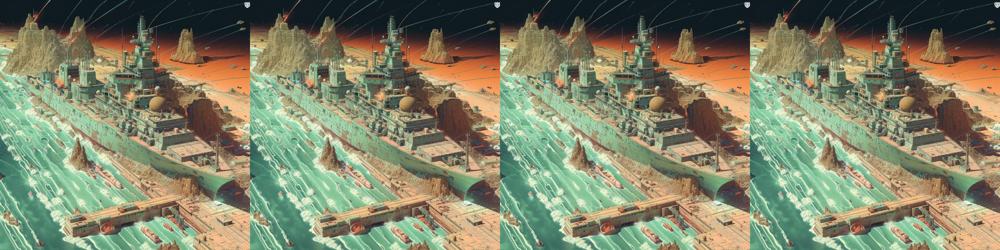

In [31]:

# @markdown ### Image URL
imgurl = "https://cdn.discordapp.com/attachments/989484060504109066/1205755893447131196/driftjohnson_CubicFuturism_style_super_futurism_cargo_ship_is_i_5b0c39b1-151b-4e04-89fe-1163797ac5eb.png?ex=65d986ae&is=65c711ae&hm=07a1b47ccbbcea59b1ddd12b33576b4e0450f5a291848cde9d2c849484f14e9b&" # @param {type:'string'}

batch_size = 4

url = imgurl
images = resize_image(download_image(url)).unsqueeze(0).expand(batch_size, -1, -1, -1).to(device)

batch = {'images': images}

show_images(batch['images'])

100%|██████████| 10/10 [00:06<00:00,  1.50it/s]


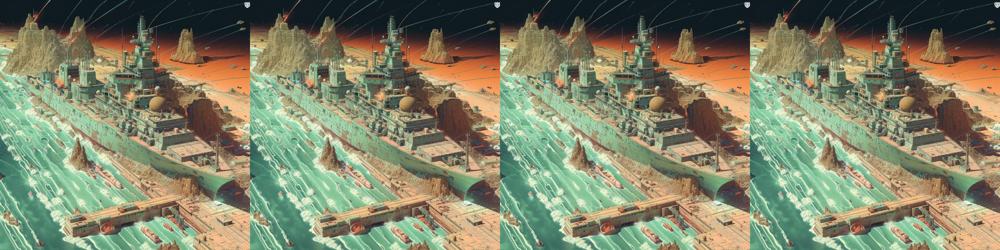

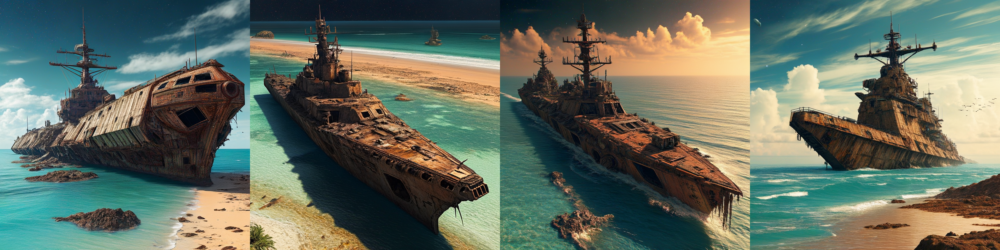

In [34]:
# @markdown ### Prompt:
prompt = "photo of a wrecked battleship rusting on the coast of a martian tropical ocean, the ship is a city populated with people around it" # @param {type:'string'}
noise_strength = 0.80  # @param {type:'number'}

# @markdown ### Stage C Parameters
Ccfg = 4  # @param {type:'number'}
Cshift = 2  # @param {type:'number'}

# @markdown ### Stage B Parameters
Bcfg = 1.1  # @param {type:'number'}
Bshift = 1  # @param {type:'number'}
Btimesteps = 10  # @param {type:'number'}
Bt_start = 1.0  # @param {type:'number'}

caption = prompt
noise_level = noise_strength
height, width = 1024, 1024
stage_c_latent_shape, stage_b_latent_shape = calculate_latent_sizes(height, width, batch_size=batch_size)

effnet_latents = core.encode_latents(batch, models, extras)
t = torch.ones(effnet_latents.size(0), device=device) * noise_level
noised = extras.gdf.diffuse(effnet_latents, t=t)[0]

# Stage C Parameters
extras.sampling_configs['cfg'] = Ccfg
extras.sampling_configs['shift'] = Cshift
extras.sampling_configs['timesteps'] = int(20 * noise_level)
extras.sampling_configs['t_start'] = noise_level
extras.sampling_configs['x_init'] = noised

# Stage B Parameters
extras_b.sampling_configs['cfg'] = Bcfg
extras_b.sampling_configs['shift'] = Bshift
extras_b.sampling_configs['timesteps'] = Btimesteps
extras_b.sampling_configs['t_start'] = Bt_start

# PREPARE CONDITIONS
batch['captions'] = [caption] * batch_size

with torch.no_grad(), torch.cuda.amp.autocast(dtype=torch.bfloat16):
    # torch.manual_seed(42)
    conditions = core.get_conditions(batch, models, extras, is_eval=True, is_unconditional=False, eval_image_embeds=False)
    unconditions = core.get_conditions(batch, models, extras, is_eval=True, is_unconditional=True, eval_image_embeds=False)
    conditions_b = core_b.get_conditions(batch, models_b, extras_b, is_eval=True, is_unconditional=False)
    unconditions_b = core_b.get_conditions(batch, models_b, extras_b, is_eval=True, is_unconditional=True)

    sampling_c = extras.gdf.sample(
        models.generator, conditions, stage_c_latent_shape,
        unconditions, device=device, **extras.sampling_configs,
    )
    for (sampled_c, _, _) in tqdm(sampling_c, total=extras.sampling_configs['timesteps']):
        sampled_c = sampled_c

    # preview_c = models.previewer(sampled_c).float()
    # show_images(preview_c)

    conditions_b['effnet'] = sampled_c
    unconditions_b['effnet'] = torch.zeros_like(sampled_c)

    sampling_b = extras_b.gdf.sample(
        models_b.generator, conditions_b, stage_b_latent_shape,
        unconditions_b, device=device, **extras_b.sampling_configs
    )
    for (sampled_b, _, _) in tqdm(sampling_b, total=extras_b.sampling_configs['timesteps']):
        sampled_b = sampled_b
    sampled = models_b.stage_a.decode(sampled_b).float()

show_images(batch['images'])
show_images(sampled)

save last image2image output to /cascade_output/

In [35]:
from PIL import Image
import torchvision.transforms as T
import os
from datetime import datetime

# Set the directory where you want to save the images
save_dir = "/content/cascade_output"
# Create the directory if it does not exist
os.makedirs(save_dir, exist_ok=True)

# Convert PyTorch tensor to PIL Images and save them
transform = T.ToPILImage()

for i, img_tensor in enumerate(sampled):
    # Generate a timestamp
    timestamp = datetime.now().strftime("%Y%m%d_%H%M%S%f")
    # Convert tensor to PIL Image
    img = transform(img_tensor.cpu())
    # Save the image with the full path and timestamp to ensure uniqueness
    img.save(os.path.join(save_dir, f'cascade_img2img_{i}_{timestamp}.png'))

# Save all images in /cascade_output/ (split to 1024x1024)

When you are finished, this can save all the images in /cascade_output/ to your google drive, if you allowed permission at the top. If you forgot, you can do that now and come straight back here so you can dump your images. This will not work if you did not save anything after each generation.

In [36]:
import os
import shutil
from PIL import Image

def split_and_save_image(image_path, dest_path):
    # Load the image
    img = Image.open(image_path)

    # Check if the image size is 4096x1024
    if img.size == (4096, 1024):
        # Split the image into four parts and save each part
        for i in range(4):
            # Define the coordinates of the cropped area
            left = i * 1024
            upper = 0
            right = left + 1024
            lower = 1024
            # Crop the image
            img_cropped = img.crop((left, upper, right, lower))
            # Save the cropped image
            base_filename = os.path.splitext(os.path.basename(image_path))[0]
            new_filename = f'{base_filename}_split_{i}.png'
            img_cropped.save(os.path.join(dest_path, new_filename))
            print(f'Split and saved {new_filename}')
    else:
        # If the image does not match the required dimensions, just copy it
        shutil.copy(image_path, dest_path)
        print(f'Copied {os.path.basename(image_path)}')

# Source and destination paths
source_dir = '/content/cascade_output'
dest_dir = '/content/drive/MyDrive/cascade_output'

# Create the destination directory if it doesn't exist
if not os.path.exists(dest_dir):
    os.makedirs(dest_dir)

# Process each file from the source directory
for filename in os.listdir(source_dir):
    if filename.lower().endswith(('.png', '.jpg', '.jpeg')):  # Check if the file is an image
        file_path = os.path.join(source_dir, filename)
        # Split and save or just copy the image to the destination directory
        split_and_save_image(file_path, dest_dir)

print('Images processed successfully.')


Copied cascade_txt2img_0_20240214_025948618783.png
Copied cascade_txt2img_2_20240214_025843325422.png
Copied cascade_img2vary_1_20240214_025417527023.png
Copied cascade_txt2img_3_20240214_025251849628.png
Copied cascade_txt2img_0_20240214_030041997141.png
Copied cascade_img2img_0_20240214_025523895554.png
Copied cascade_img2img_2_20240214_030447840816.png
Copied cascade_txt2img_1_20240214_030042395412.png
Copied cascade_img2vary_3_20240214_025418348401.png
Copied cascade_img2img_0_20240214_030351783535.png
Copied cascade_txt2img_2_20240214_025251198102.png
Copied cascade_img2img_2_20240214_025524948629.png
Copied cascade_img2img_0_20240214_030446878493.png
Copied cascade_img2img_2_20240214_030352746165.png
Copied cascade_img2img_1_20240214_025524451843.png
Copied cascade_img2img_1_20240214_030352307005.png
Copied cascade_txt2img_3_20240214_030043124926.png
Copied cascade_txt2img_1_20240214_025250535772.png
Copied cascade_txt2img_0_20240214_025842308825.png
Copied cascade_txt2img_3_2024